<font size="6" color=35483A><span style='font-family:Bell MT'>FreedomWings Presents:</font>

# <font size="10" color=#952816><center><span style='font-family:Bell MT'>UFO Sightings Exploratory Data Analysis</center></font>

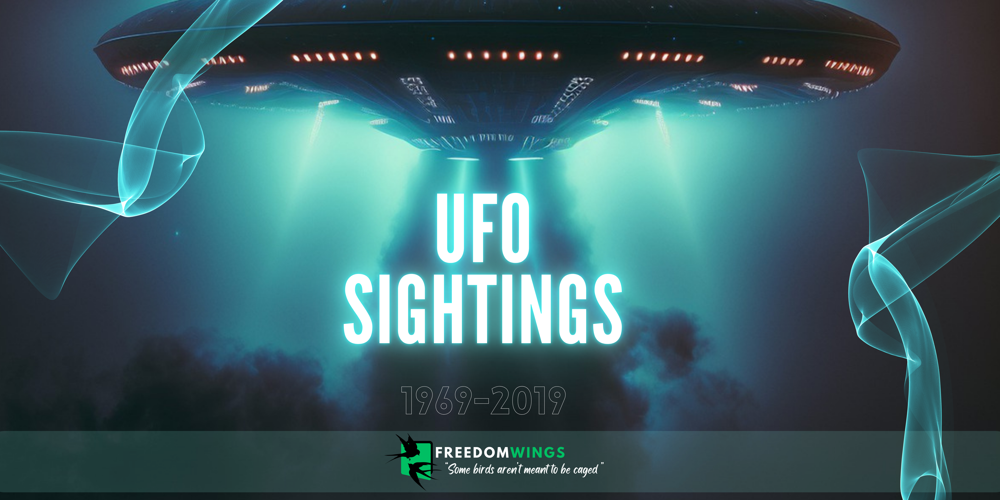

# <font color= ##033295  ><span style='font-family:Bell MT'>Project Objective:</span></font>

<div class="alert alert-success" markdown="1">
<font size="3"><center></font>
* The following outlines the aim of conducting an analysis on this dataset.

</div>

#### UFO Reports

&#x2071; This dataset comprises eyewitness UFO reports collected by the National UFO Research Center (NUFORC). It includes various attributes associated with the reports, making it an intriguing subject for data analytics exploration. I have selected this dataset for three reasons:    

- Data Cleaning techniques:  
> This serves as an illustrative demonstration of effective techniques for tidying up a large dataset, encompassing over 141,000 lines. It also provides insights into troubleshooting issues related to missing data, data challenges, and more  
- Data Analytics:
> I will demonstrate how to extract valuable insights from this dataset and analyze the data to make sense of it, focusing on identifying key areas where UFOs have been spotted. The objective is to discern patterns or insights from the gathered information. Visualizations within this project will play a crucial role in facilitating this analysis  


#### UFO's & UAP's
> If you have a interest in this subject,
[check this out](https://www.youtube.com/watch?v=sm6AL5lA4Zc)


# <font color='red'><center>_____ _________________ _____________________________</center></font>

# <font color= ##033295  ><span style='font-family:Bell MT'> Dataset Overview</span></font>

<div class="alert alert-success" markdown="1">
<font size="3"><center></font>
* Below is an overview of the dataset pertinent to this project.

</div>

#### 1) Dataset:


> Name:  nuforc_reports.csv  
Owner:  <a href="https://data.world/timothyrenner">Timothy Renner</a>  
Shared: With Everyone, Public Domain  
Size (csv): 412.79mb  
Nr Columns: 13  
Nr rows: 141359  
Original Dataset can be found <a href="https://data.world/timothyrenner/ufo-sightings">HERE</a> 

#### 2) About:
This dataset contains eye witness ufo reports that was collected by The National UFO Research Center.

#### 3) Data Features:  

##### *Describing the columns:* 
`summary:` This column is a summary of the column 'text', describing the details of the ufo encounter.  
`city:` The city in which the encounter occured.  
`state:` The US State in which the encounter occured.  
`date_time:` The date and time the encounter occured.  
`shape:` The UFO shape.  
`duration:` The time duration in which the encounter occured.  
`stats:` The summary of the encounter: date, time, shape, location ect.  
`report_link:` The hyperlink to the original data captured (National UFO Reporting Center Sighting Report).  
`text:` The eye witness details describing the encounter.  
`posted:` When the encounter was posted/reported.  
`city_latitude & city_longitude:` Co-ordinates of the encounter.



# <font color='red'><center>_____ _________________ _____________________________</center></font>

## <font size="5" color=#952816 ><span style='font-family:Bell MT'> Step 1: Importing Modules:</span></font>


In [844]:
#====== Importing Modules needed for Notebook:
#==== Operations:
import numpy as np        # Numerical operations library
import pandas as pd       # Data manipulation library

import warnings
warnings.filterwarnings("ignore")   # Suppressing warnings for cleaner output
from datetime import datetime   # Library for working with date and time
import re   # Regular expression library for text manipulation

#==== Visualisations:
import PIL.Image   # Python Imaging Library for working with images
import seaborn as sns     # Statistical data visualization library
import plotly.express as px   # Interactive plotting library
import plotly.graph_objects as go

import matplotlib.pyplot as plt   # Plotting library
%matplotlib inline
from matplotlib import font_manager as fm


#====== Geospatial:
import geopandas as gpd      # Geospatial data manipulation library
import fiona
fiona.drvsupport.supported_drivers['ESRI Shapefile'] = 'rw'  # Configuring support for ESRI Shapefiles

#====== NLP:
import nltk   # Natural Language Toolkit library for text processing
from nltk.tokenize import sent_tokenize   # Tokenizing sentences

from collections import Counter   # Collection data type for counting occurrences

from nltk.corpus import stopwords   # Stopwords for text processing

## <font size="5" color=#952816 ><span style='font-family:Bell MT'> Step 2: Creating a  Dataframe:</span></font>

<div class="alert alert-success" markdown="1">

<font size="3"><center></font>
&#x2071; 
I will create a dataframe using the CSV file "nuforc_reports.csv". The main goal of this section is to read the raw data and understand its features: what the data reveals, whether feature engineering is needed, if there are any missing values that require attention, and any other aspects that need consideration. It's crucial in any Exploratory Data Analysis (EDA) to first and foremost understand the nature of the data and make initial observations before delving into further analysis. My methodology for this is demonstrated within this notebook through the systematic approach I've adopted, along with detailed notes and explanations.  
</div>

<font size="4" color=green ><span style='font-family:Bell MT'> Encoding:</span></font>

In [845]:
#====== List of encodings to try when reading the CSV file:
try_encodings = ['utf-8', 'iso-8859-1', 'utf-16']

#====== Iterating through the encodings to find out encoding format for csv file:
for encoding in try_encodings:
    try:
        ufo_df = pd.read_csv("ufo_sightings.csv", encoding = encoding)
        encoding_type = encoding
        print(f'''============ Feedback: =============
        \rSuccessfully read using {encoding} encoding.''')
        
        break
    except UnicodeDecodeError:
        print(f"Failed to read using {encoding} encoding.")


============ Feedback: =============
Successfully read using utf-8 encoding.


<font size="4" color=green ><span style='font-family:Bell MT'> Dataframe:</span></font>

In [846]:
#====== Generating a dataframe:
ufo_df = pd.read_csv("ufo_sightings.csv", encoding = encoding_type)


In [847]:
#====== Setting a styled format to read the dataframe:
def style_dataframe(df):
    
    styled_df = df.style.set_properties(**{ # Parameters listed below:
        'border': '2px solid green',
        'color': 'white',
        'background-color': '#0B164B',
        'font-weight': 'bold',
        'font-size': '14px',
        'text-align': 'left',
        'font-family': 'Arial',
        'padding': '10px',
        'margin': '5px',
        'white-space': 'nowrap',
        'text-decoration': 'underline'
    })
    
    return styled_df

In [848]:
#====== Reading dataframe with styled format:
style_dataframe(ufo_df.head(10))

,summary,country,city,state,date_time,shape,duration,stats,report_link,text,posted,city_latitude,city_longitude
0,MADAR Node 100,USA,Mountlake Terrace,WA,2019-06-23T18:53:00,nan,nan,"Occurred : 6/23/2019 18:53 (Entered as : 06/23/19 18:53) Reported: 6/26/2019 7:08:30 AM 07:08 Posted: 6/27/2019 Location: Mountlake Terrace, WA Shape:",http://www.nuforc.org/webreports/reports/147/S147087.html,MADAR Node 100,2019-06-27T00:00:00,47.794100,-122.306600
1,Steady flashing object with three lights hovered in sky,USA,Hamden,CT,2019-06-23T20:00:00,light,5 hours,"Occurred : 6/23/2019 20:00 (Entered as : 6/23/19 20:00) Reported: 6/25/2019 12:27:53 PM 12:27 Posted: 6/27/2019 Location: Hamden, CT Shape: Light Duration: 5 hours Characteristics: There were lights on the object, There was an aura or haze around the object, The object emitted other objects, The object emitted beams, There were aircraft in the vicinity or aircraft chasing the object",http://www.nuforc.org/webreports/reports/147/S147062.html,"Steady flashing object with three lights hovered in sky Saw three bright lights in a row - the actual shape looked like a disk Several helicopters monitored it- one was still, others did circle around it, The lights seemed to change formation, but remained steady on - Husband is into planes and helicopters and confirmed it was not either, nor was it a drone What got our attention was the behavior of the helicopters that seemed to monitor it",2019-06-27T00:00:00,41.373941,-72.921325
2,"Group of several orange lights, seemingly circular. Lights did not blink. ((anonymous report))",USA,Charlottesville,VA,2019-06-20T23:28:00,circle,15 seconds,"Occurred : 6/20/2019 23:28 (Entered as : 06/20/19 11:28) Reported: 6/20/2019 8:36:51 PM 20:36 Posted: 6/27/2019 Location: Charlottesville, VA Shape: Circle Duration: 15 seconds Characteristics: There were lights on the object",http://www.nuforc.org/webreports/reports/146/S146944.html,"Group of several orange lights, seemingly circular. Lights did not blink. Object appeared to be like a plane, but the color and speed wasn’t correct, and it seemed closer and lower than a plane. Slow and steady course. After it disappeared into the clouds, the same exact thing happened about 1-2 minutes later (a second identical object on what seemed like the same flight path). ((NUFORC Note: Time indicated by witness may have been flawed. We have amended it, in order to indicate a nighttime sighting. Witness elects to remain totally anonymous; provides no contact information, so we are unable to confirm the time. PD))",2019-06-27T00:00:00,38.055968,-78.494482
3,Dropped in flashed a few times and shot off 5 or 6 balls of light then shot back up extermly fast. ((anonymous report)),USA,Lincoln Park,MI,2019-06-21T00:00:00,light,2 minutes,"Occurred : 6/21/2019 00:00 (Entered as : 06/21/2019 0:00) Reported: 6/20/2019 10:07:37 PM 22:07 Posted: 6/27/2019 Location: Lincoln Park, MI Shape: Light Duration: 2 minutes Characteristics: There were lights on the object, The object emitted other objects, The object emitted beams, This is a possible UFO abduction case",http://www.nuforc.org/webreports/reports/146/S146962.html,"Dropped in flashed a few times and shot off 5 or 6 balls of light, then shot back up extermly fast. Taking the dogs out; quite a sight over the house. ((NUFORC Note: Witness elects to remain totally anonymous; provides no contact information. PD))",2019-06-27T00:00:00,42.238500,-83.178300
4,"Location: While traveling in a TGV, from Lille to Charles du Gaule airport - Paris, after the outskirts of Douai. Aprox train locati",France,Douai (France),nan,2019-06-07T20:00:00,cigar,5 minutes,"Occurred : 6/7/2019 20:00 (Entered as : 06/07/2019 20:00) Reported: 6/20/2019 11:47:36 AM 11:47 Posted: 6/27/2019 Location: Douai (France), Shape: Cigar Duration: 5 minutes",http://www.nuforc.org/webreports/reports/146/S146959.html,"Location: While traveling in a TGV, from Lille to Charles du Gaule airport - Paris, after the outskirts of Dou

<font size="4" color=green ><span style='font-family:Bell MT'> Describing:</span></font>

In [849]:
#===== Checking column names and data types:
ufo_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 141261 entries, 0 to 141260
Data columns (total 13 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   summary         141189 non-null  object 
 1   country         140944 non-null  object 
 2   city            140779 non-null  object 
 3   state           131681 non-null  object 
 4   date_time       138601 non-null  object 
 5   shape           134962 non-null  object 
 6   duration        133642 non-null  object 
 7   stats           141261 non-null  object 
 8   report_link     141261 non-null  object 
 9   text            141227 non-null  object 
 10  posted          138601 non-null  object 
 11  city_latitude   115440 non-null  float64
 12  city_longitude  115440 non-null  float64
dtypes: float64(2), object(11)
memory usage: 14.0+ MB


## <font size="5" color=#952816 ><span style='font-family:Bell MT'> Step 3: Checking Missing Values::</span></font>

<font size="4" color=green ><span style='font-family:Bell MT'> Nan Values:</span></font>

In [850]:
#====== Checking sum of missing values per column:
print("====== \u274f Missing Values: =======")

ufo_df.isna().sum()

====== ❏ Missing Values: =======


summary              72
country             317
city                482
state              9580
date_time          2660
shape              6299
duration           7619
stats                 0
report_link           0
text                 34
posted             2660
city_latitude     25821
city_longitude    25821
dtype: int64

<font size="4" color=green ><span style='font-family:Bell MT'> Missing ratio:</span></font>

In [851]:
#====== Check total number of rows within dataset:
num_rows = len(ufo_df)

#====== Checking total number of missing values:
total_NaN = sum(ufo_df.isna().sum())

#====== Check how many rows have missing values:
total_missing_rows = ufo_df.isna().any(axis=1).sum()

#====== Calculate the missing value ratio percentage:
missing_ratio = (total_missing_rows / num_rows) * 100

#====== Printing out Findings:
print(f'''====================== Findings: ===================== 
Total number of rows:                     {num_rows}
Total number of missing values:           {total_NaN}
Total number of rows with missing values: {total_missing_rows}
Ratio percentage:                         {round(missing_ratio)}%
======================================================
''')


====================== Findings: ===================== 
Total number of rows:                     141261
Total number of missing values:           81365
Total number of rows with missing values: 36098
Ratio percentage:                         26%



# <font color='red'><center>_____ _________________ _____________________________</center></font>

# <font color= ##033295  ><span style='font-family:Bell MT'> Data Cleaning Overview </span></font>


#### Missing Values Observations:

1. There is a notable prevalence of missing values within the columns, and the corresponding missing ratio stands at a significant 26%. Consequently, I am inclined not to remove these missing values, as doing so could potentially undermine the accuracy of the analysis I intend to conduct.  


2. Among the columns, those pertaining to city, state, and coordinates exhibit the most substantial occurrences of missing values. To address this issue without eliminating any missing data, I will need to employ imputation techniques.  

====== ❏ Missing Values: =======  
summary              72  
country             317  
city                478  
state              9580  
date_time          2660  
shape              6299  
duration           7616  
stats                 0  
report_link           0  
text                 34  
posted             2660  
city_latitude     25821  
city_longitude    25821  

#### Describing the columns:
* We will analyze the details within each column and explore potential approaches to address the presence of missing values.  



> `Summary`  
Initially, the 'summary' column exhibits fewer missing values compared to the 'text' column. <span style="color:red">  
Therefore, I intend to drop the 'text' column.    
Given that the summarization format within the 'summary' column is inadequate, I plan to eliminate this column, create a new one, and employ sentiment analysis instead-extracting the data from the 'summary' column before deleting. 

> `city`       
*The city in which encounter occured.*    
The general format of this column is as example: Caloocan City (Philippines). It has the city and the country name in brackets.  
    <span style="color:red"> I want the city and country to be seperate, so I will therfore extract the country from this column and impute it into the country column.  

> `state`  
*The US State in which encounter occured.*     
This is expected to be a large amount of missing values since not all countries have states, ie- unique only to US.  
<span style="color:red">I will therefore perform imputation and label the missing values as 'unknown' and use the state codes to fill data in country column for USA.

> `date_time`  
*The date and time encounter occured.*    
The general format of this column is as example: (YYYY-MM-DDTHH:mm:ss)1988-08-10T15:00:00.  
<span style="color:red">I will therfore change the date format to exclude the time. 

> `shape`  
*The UFO shape.*   
<span style="color:red">I will identify the distinct/unique shapes mentioned, and I have the option to either use the average described shape for filling in the gaps or label the absent values as 'other'.

> `duration`  
*The time duration in which encounter occured.*   
The format of this data is too mixed making it difficut to convert to a specific duration format.   
<span style="color:red">I will therfore drop this column aswell

> `stats`  
*The summary of event: date,time,shape,location ect.*   
<span style="color:red">I will drop this column as I do not need the summary as I will be performing my own EDA on this dataset.

> `report_link`  
*The hyperlink to the original data captured (National UFO Reporting Center Sighting Report).*   
<span style="color:red">I will drop this column as wont be needed for data analysis

> `text`   
*The details describing the encounter*     
<span style="color:red">As mentioned above will also drop this column

> `posted`  
*When the event was posted/reported.*     
<span style="color:red">I will also drop this column as I dont need to know when the report was posted, its irrelevant. 

> `city_latitude`  
*The latitude location*   
<span style="color:red">I will refine this column with merging with another dataset

> `city_longitude`   
*The longitude location*     
<span style="color:red">I will refine this column with merging with another dataset


<div style="background-color: red; height: 5px;"></div>

## <font size="5" color=#952816 ><span style='font-family:Bell MT'> Step 4: Data Clean and Preparing:</span></font>

<font size="4" color=green ><span style='font-family:Bell MT'> Checking Unique columns:</span></font>

In [852]:
#====== Checking columns unique values and frequency/counts:
for col in ufo_df.iloc[:,1:].select_dtypes(include = 'object').columns:
    print(col)

    print("------------------------------------")
    print(ufo_df[col].value_counts(normalize = True))
    print("------------------------------------")

country
------------------------------------
country
USA                  0.893007
Canada               0.040449
United Kingdom       0.022193
Australia            0.006286
India                0.003143
                       ...   
Republic of Korea    0.000007
Ochorios             0.000007
Tyrrhenian Sea       0.000007
none                 0.000007
USVI                 0.000007
Name: proportion, Length: 439, dtype: float64
------------------------------------
city
------------------------------------
city
New York                         0.006187
Phoenix                          0.005619
Seattle                          0.005555
Las Vegas                        0.004781
Portland                         0.004660
                                   ...   
Ein Geidi Beach (Israel)         0.000007
Chatham Maritime (UK/England)    0.000007
Coastline                        0.000007
Szekesfehervar (Hungary)         0.000007
Cappagh                          0.000007
Name: proportion, Length:

<font size="4" color=green ><span style='font-family:Bell MT'> Duplicates:</span></font>

In [853]:
#====== Checking duplicates:
ufo_df.duplicated().sum()

0

<font size="4" color=green ><span style='font-family:Bell MT'> Columns drop:</span></font>

In [854]:
#====== Drop the columns not needed:
columns_to_drop = ["duration","report_link","text","posted"]
ufo_df.drop(columns_to_drop, axis = 1, inplace = True)

#====== Displaying updated columns:
ufo_df.columns.to_list()

['summary',
 'country',
 'city',
 'state',
 'date_time',
 'shape',
 'stats',
 'city_latitude',
 'city_longitude']

<font size="4" color=green ><span style='font-family:Bell MT'> Column: summary</span></font>

<div class="alert alert-success">
    
`Summary clean:`
    
* Replacing all character strings to empty spaces in order to read text more efficiently.  
-Checking the total number of hoaxes picked up by the National UFO Reporting Center Sighting Report.   
-Checking the word hoax by setting the conditions to convert all text to lowercase.  
-Setting the expressions r'\bhoax\b' in order to search of instances of the complete word, ignoring cases where it might be part of a larger word.  
-Remove or filter out rows from the DataFrame where the 'summary' column contains the word 'Hoax' (case-insensitive) as a whole word.It then updates the df to contain only the rows where this condition is not met.

</div>

In [855]:
#====== Checking missing values in 'summary':
ufo_df['summary'].isna().sum()

72

In [856]:
#====== Filling missing values with 'unknown':
ufo_df['summary'].fillna('unknown', inplace = True)


In [857]:
#====== Defining a function to replace characters in strings:
def clean_summary(summary):

    cleaned_summary = summary.replace('(', '').replace(')', '').replace('/', ' ').replace('-', '').replace(',', '').strip()
    return cleaned_summary

#====== Apply the function to the summary column:
ufo_df['summary'] = ufo_df['summary'].apply(clean_summary)

In [858]:
#====== Checking total values of hoaxes declared:
hoax_count = ufo_df['summary'].str.lower().str.count(r'\bhoax\b').sum() # Counting nr of time 'hoax' appears
print("Total occurrences of 'HOAX' in the summary column:\n",hoax_count)


Total occurrences of 'HOAX' in the summary column:
 1446


In [859]:
#====== Removing rows containing 'hoax':
ufo_df = ufo_df[~ufo_df['summary'].str.contains(r'\bHoax\b', case = False)]

#====== Confirming that hoaxes have been removed:
hoax_count = ufo_df['summary'].str.lower().str.count(r'\bhoax\b').sum()
print("Total occurrences of 'HOAX' in the summary column:\n",hoax_count)


Total occurrences of 'HOAX' in the summary column:
 0


<font size="4" color=green ><span style='font-family:Bell MT'> Column: state</span></font>

<div class="alert alert-success">
    
`Clean State:`
    
* Fill in missing values with 'unspecified'.

</div>

In [860]:
#====== Checking missing values again:
ufo_df['state'].isna().sum()

9432

In [861]:
#====== Filling in missing values:
ufo_df['state'].fillna('unspecified', inplace = True)

<font size="4" color=green ><span style='font-family:Bell MT'> Column: Country</span></font>

<div class="alert alert-success">
    
`Clean Country:`

>Creating a new DataFrame by opening the file named 'worldcities_refined.'  
> * Dropping all missing values in that new dataframe  
> * Extracting values from the 'city' and 'country' columns, pairing them using the zip function, and storing the pairs in a dictionary. This will enable mapping cities to their respective countries using the data in this new DataFrame. The mapping will be applied to the existing ufo_df DataFrame, replacing all 'unspecified' values.  

* The remaining 'unspecified' values that I was not able to map, will be changed to the average country


</div>


In [862]:
#====== Checking missing values again:
ufo_df['country'].isna().sum()


297

In [863]:
#====== Filling missing values to 'unspecified':
ufo_df['country'].fillna('unspecified', inplace = True)

'''
Saving total nr of 'unspecified' countries to a variable:
I am saving the total to check later for before and after mapping
'''
before_mapping = ufo_df['country'].value_counts().get('unspecified', 0)

#====== Confirming if all missing values have been replaced:
ufo_df['country'].isna().sum()


0


#### 1) New Dataset (country mapping):

Utilizing a global city dataset, which serves as a valuable resource for various mapping techniques. This dataset comprises approximately 43,000 distinct cities and towns spanning every country worldwide, complete with latitude and longitude coordinates. The dataset's most recent update was completed on March 31, 2023. I have `refined the original csv dataset by deleting the columns and creating 2 columns showing city and country respectably.`

> Name:  worldcities.csv  
Owner:  <a href="https://www.kaggle.com/juanmah">Juanma Hernández</a>  
Shared: With Everyone, Public Domain  
Size (csv):2mb  
Original Dataset can be found <a href="https://www.kaggle.com/datasets/juanmah/world-cities">HERE</a> 

In [864]:
#====== Creating new Data frame:
city_country_df = pd.read_csv('worldcities_refined.csv')

#====== Checking missing values:
city_country_df.isna().sum()


city       316
country      0
dtype: int64

In [865]:
#====== Dropping all missing values:
city_country_df.dropna(inplace = True)

In [866]:
#====== Creating a dictionary mapping cities to their respective countries:
city_to_country_mapping = dict(zip(city_country_df['city'], city_country_df['country']))

In [867]:
#======Identifying all rows with 'unspecified' in the 'country' column:
unspecified_rows = ufo_df[ufo_df['country'] == 'unspecified']

#====== Iterating through rows with 'unspecified' in the 'country' column and updating based on mapping:
for index, row in unspecified_rows.iterrows():
    city = row['city']   # Extracting the city value from the current row
    if city in city_to_country_mapping:   # Checking if city is present in the mapping dictionary
        # Updating the 'country' column with the mapped country for the current city
        ufo_df.at[index, 'country'] = city_to_country_mapping[city]

#====== Saving results to variables:
after_mapping = ufo_df['country'].value_counts().get('unspecified', 0)

#====== Printing Results:
print(f'''
Country column values BEFORE mapping:{before_mapping}
Country column AFTER before mapping:{after_mapping}
Total nr of unspecified countries replaced: {before_mapping - after_mapping}
''')


Country column values BEFORE mapping:297
Country column AFTER before mapping:223
Total nr of unspecified countries replaced: 74



In [868]:
'''
Although we've handled 74 unspecified values, there are still 223 remaining to address:
'''

#====== Calculating the average country value:
average_country = ufo_df['country'].mode()[0] #returns a Series object(first value)

#====== Replacing 'unspecified' with the average country value:
ufo_df['country'].replace('unspecified', average_country, inplace=True)

#====== Confirm that all unspecified countries have been replaced:
final_mapping = ufo_df['country'].value_counts().get('unspecified', 0)
print(final_mapping)


0


<font size="4" color=green ><span style='font-family:Bell MT'> Column: city</span></font>

<div class="alert alert-success">
    
`Clean City:`
    
* Fill in missing values with 'unspecified'.  
- Setting a function to replace the string characters with empty spaces in order to read more effectively.  
- Applying function to the city column



</div>

In [869]:
#====== Checking missing values:
ufo_df['city'].isna().sum()

449

In [870]:
#====== Filling missing values:
ufo_df['city'].fillna('unspecified', inplace=True)

In [871]:
#====== Defining a function to replace characters in strings:
def clean_city(city):

    cleaned_city = city.replace('(', '').replace(')', '').replace('/', ' ').replace(',', '').strip()
    return cleaned_city

#====== Applyimg the above function to the 'city' column:
ufo_df['city'] = ufo_df['city'].apply(clean_city)


In [872]:
#====== Viewing total nr of occurences of unique cities:
ufo_df['city'].value_counts()

city
New York                   854
Phoenix                    785
Seattle                    779
Las Vegas                  668
Portland                   649
                          ... 
Pleasant Lake                1
Bucerias Nayarit Mexico      1
Tarrant City                 1
Mantova Italy                1
Cappagh                      1
Name: count, Length: 23649, dtype: int64

<font size="4" color=green ><span style='font-family:Bell MT'> Column: date_time</span></font>

<div class="alert alert-success">
    
`Clean Date:`
    
* Checking Missing values
- Converting the date_time column to datetime objects.  
- Formatting 'date_time' to include only the date, excluding time entries.
- Parsing the 'date_time' values into a new column 'date_only'.   
> To address missing values, I plan to impute them by extracting data from the 'stats' column and using it to replace the missing values. Since the 'stats' column may contain dates, some rows might lack dates in the 'date_time' column but have them in the 'stats' column. I intend to match and impute the missing values accordingly.  
     
- Defining a function to search for datetime values in the 'stats' column using the re.search function from the re module for regex pattern matching. If a match is found, it will replace the missing value; otherwise, it will return pd.NaT (used in pandas to represent missing or undefined datetime values).
- Executing this function within a temporary new column 'date_extracted', then using it to replace the values in the original 'date_only' column. 
- After executing this code, I will drop the remaining missing values.
    
</div>

In [873]:
#====== Checking missing values:
ufo_df['date_time'].isnull().sum()

2622

In [874]:
#====== Converting to date time format:
ufo_df['date_time'] = pd.to_datetime(ufo_df['date_time'])

#====== Extracting date only and parsing to a new column:
ufo_df['date_only'] = ufo_df['date_time'].dt.date  

#====== Dropping the original 'date_time' column:
ufo_df.drop(columns = ['date_time'], inplace = True)


In [875]:
#====== Defining a function to extract the date from the 'stats' column:
def extract_date(stats):
    match = re.search(r'(\d{1,2}/\d{1,2}/\d{4})', stats)
    if match:
        return match.group(0)
    else:
        return pd.NaT 
    
#====== Applying the function to extract the date and create a new 'date_extracted' column:
ufo_df['date_extracted'] = ufo_df['stats'].apply(extract_date)

#====== Convert the 'date_extracted' column to datetime:
ufo_df['date_extracted'] = pd.to_datetime(ufo_df['date_extracted'], errors = 'coerce')

#====== Replace missing values in 'date_only' with the extracted dates:
ufo_df['date_only'].fillna(ufo_df['date_extracted'], inplace = True)

#====== Drop the temporary 'date_extracted' column
ufo_df.drop(columns = ['date_extracted'], inplace=True)

In [876]:
#====== Checking new missing values total:
ufo_df['date_only'].isna().sum()

5

In [877]:
#====== Dropping final rows with missing dates:
ufo_df.dropna(subset = ['date_only'], inplace = True)

#====== Checking new missing values total:
ufo_df['date_only'].isna().sum()

0

<font size="4" color=green ><span style='font-family:Bell MT'> Column: shape</span></font>

<div class="alert alert-success">
    
`Clean Shape:`


* Checking for missing and unique values.
* Performing imputation for missing values:
> * Defining a function to group unique shape values and categorize them to reduce uniqueness and simplify the data.
> * Creating a variable named 'ufo_shapes' to store the resulting list of unique shape values.
> * Executing code to search for matching keywords within the 'ufo_shapes' list in the 'summary' column. When a match is found, it replaces the 'unspecified' values with the corresponding keyword from the 'ufo_shapes' list.
The function uses a lambda row function to apply the specified condition to each row in the DataFrame.
The line next((shape for shape in ufo_shapes if shape in row['summary'].lower()), row['shape']) is a generator expression that iterates over the 'ufo_shapes' list and checks if any of the shapes are present in the lowercase version of the 'summary' column (row['summary'].lower()). The next function returns the first matching shape or row['shape'] if no match is found.
Calculating the most common shape per city by grouping the data by the 'city' column and categorizing by 'shape'.
> * Merging the grouped 'avg_shape_per_city' data back into the 'ufo_df' DataFrame.
> * Applying a function to replace the 'unspecified' values with the most common shape for each city.

In [878]:
#====== Checking missing values:
ufo_df['shape'].isnull().sum()

6218

In [879]:
#====== Filling missing values:
ufo_df['shape'].fillna('unspecified', inplace = True)

In [880]:
#====== Viewing Unique values for shape:
ufo_df['shape'].value_counts()

shape
light          28341
circle         14932
triangle       12463
fireball        9592
other           9553
unknown         9439
sphere          9109
disk            8200
unspecified     6218
oval            6056
formation       4641
changing        3599
cigar           3502
rectangle       2417
flash           2347
cylinder        2275
diamond         2004
chevron         1604
egg             1189
teardrop        1180
cone             570
cross            461
star              91
delta             34
Name: count, dtype: int64

In [881]:
#====== Defining fuction that replaces values:
def replace_column_value(df, column_name, old_value, new_value):
    df[column_name] = df[column_name].replace(old_value, new_value)

#====== Executing function to categorise the ufo shapes:
replace_column_value(ufo_df, 'shape', 'egg', 'oval')
replace_column_value(ufo_df, 'shape', 'circle', 'sphere')
replace_column_value(ufo_df, 'shape', ['flash','changing','star'], 'light')
replace_column_value(ufo_df, 'shape', ['unknown','cross','other'], 'unspecified')
replace_column_value(ufo_df, 'shape', 'cylinder', 'cigar')
replace_column_value(ufo_df, 'shape', ['delta','chevron'], 'triangle')


In [882]:
#====== Viewing Unique values for shape:
ufo_df['shape'].value_counts()

shape
light          34378
unspecified    25671
sphere         24041
triangle       14101
fireball        9592
disk            8200
oval            7245
cigar           5777
formation       4641
rectangle       2417
diamond         2004
teardrop        1180
cone             570
Name: count, dtype: int64

In [883]:
#====== Setting variable containing unique categories:
ufo_shapes = ['light', 'sphere', 'cigar', 'unspecified', 'triangle', 'oval',
              'teardrop', 'rectangle', 'formation', 'fireball', 'disk',
              'diamond', 'cone']

#====== Applying custom function to update the shape column.
ufo_df['shape'] = ufo_df.apply(lambda row: next((shape for 
                                                 shape in ufo_shapes if shape in row['summary'].lower())
                                                , row['shape']) if row['shape'] == 'unspecified' else row['shape'], axis=1)

In [884]:
#====== Viewing Unique values for shape:
ufo_df['shape'].value_counts()

shape
light          43798
sphere         24220
unspecified    15231
triangle       14221
fireball        9722
disk            8232
oval            7303
cigar           5869
formation       4979
rectangle       2436
diamond         2033
teardrop        1187
cone             586
Name: count, dtype: int64

In [885]:
#====== Calculating avg shape per city:
avg_shape_per_city = ufo_df.groupby('city')['shape'].agg(lambda x: x.mode().iloc[0]).reset_index()
avg_shape_per_city.columns = ['city', 'avg_shape']

#====== Merging the average shapes back into the original DataFrame:
ufo_df = ufo_df.merge(avg_shape_per_city, on='city', how = 'left')

#====== Replacing 'unspecified' shapes with the corresponding average shape:
ufo_df['shape'] = ufo_df.apply(lambda row: row['avg_shape'] if row['shape'] == 'unspecified' else row['shape'], axis = 1)

#====== Dropping the temporary 'avg_shape' column:
ufo_df = ufo_df.drop('avg_shape', axis=1)

In [886]:
#====== Viewing final unique values for shape:
ufo_df['shape'].value_counts()

shape
light          53045
sphere         25118
triangle       14431
fireball        9930
disk            8487
oval            7401
cigar           6037
formation       5062
unspecified     3979
rectangle       2453
diamond         2085
teardrop        1194
cone             595
Name: count, dtype: int64

<font size="4" color=green ><span style='font-family:Bell MT'> Column: Latitude & Longitude</span></font>

<div class="alert alert-success">
    
`Clean Co-ordinates:`


* Checking for missing values.   
* Performing imputation for missing values:
* Merge ufo_df with world_cities_df to enrich the UFO data with latitude and longitude information.
The merge is based on the 'city' column using a left join strategy.
This ensures all rows from ufo_df are included, with matching rows from world_cities_df added based on the 'city' column.
* Update 'city_latitude' in ufo_df by filling missing values with latitude information from world_cities_df.
The 'combine_first' method is used to prioritize latitude information from world_cities_df when available, while falling back to the original 'city_latitude' values from ufo_df for non-matching rows.

In [887]:
#====== Checking missing values:
ufo_df[['city_latitude','city_longitude']].isna().sum()

city_latitude     25458
city_longitude    25458
dtype: int64

In [888]:
#====== Setting a new DataFrame:
world_cities_df = pd.read_csv('worldcities.csv')

In [889]:
#====== Merge DataFrames based on 'city' column:
merged_df = pd.merge(ufo_df, world_cities_df[['city', 'lat', 'lng']], on = 'city', how = 'left')

#====== Replace latitude and longitude columns in ufo_df with values from world_cities_df:
ufo_df['city_latitude'] = merged_df['lat'].combine_first(ufo_df['city_latitude'])
ufo_df['city_longitude'] = merged_df['lng'].combine_first(ufo_df['city_longitude'])


In [890]:
#====== Checking missing values:
ufo_df[['city_latitude','city_longitude']].isna().sum()

city_latitude     4544
city_longitude    4544
dtype: int64

In [891]:
#====== Drop rows with missing values in 'city_latitude' and 'city_longitude':
ufo_df.dropna(subset=['city_latitude', 'city_longitude'], inplace = True)


<font size="4" color=green ><span style='font-family:Bell MT'> Final check on missing values:</span></font>

In [892]:
ufo_df.isna().sum()

summary           0
country           0
city              0
state             0
shape             0
stats             0
city_latitude     0
city_longitude    0
date_only         0
dtype: int64

In [893]:
#======== ML COPY:
ml_df = ufo_df.copy()

<div class="alert alert-info">
 Data assessment post-cleaning:
    
`With all the data now cleaned, prepared, and missing values addressed, I can proceed to data analysis and visualization.`
</div>

<div style="background-color: red; height: 5px;"></div>



# <font color= ##033295  ><span style='font-family:Bell MT'> Data Visualisations:</span></font> 


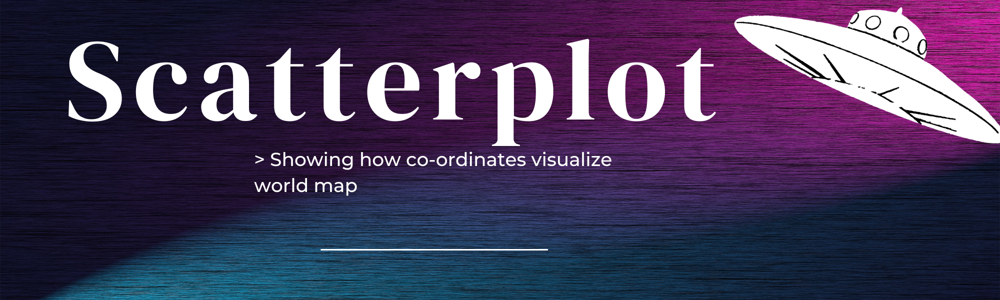

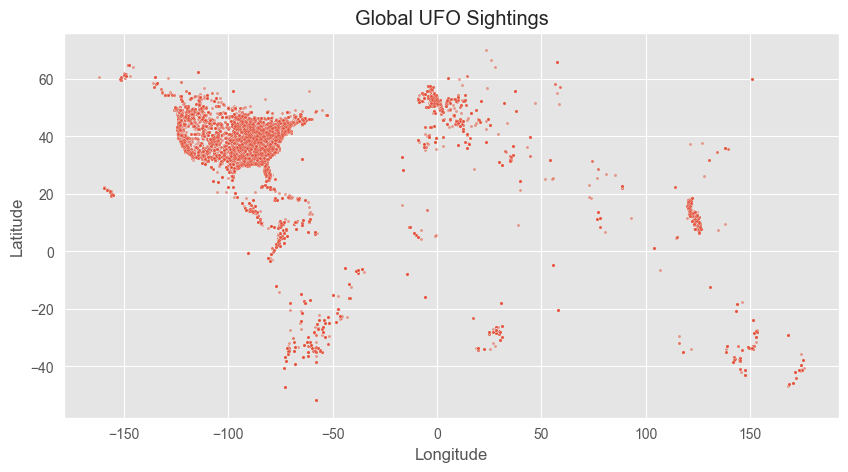

In [894]:
#================ Creating a scatter plot of coordinates with world-map overlay

#====== Extract latitude and longitude columns:
latitude = ufo_df['city_latitude']
longitude = ufo_df['city_longitude']

#====== Create a scatter plot using Seaborn:
plt.figure(figsize = (10, 5))
sns.scatterplot(x = longitude, y = latitude, s = 5, alpha = 0.5)

#====== Add labels and title:
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Global UFO Sightings')

#====== Show the plot:
plt.grid(True)  
plt.show()

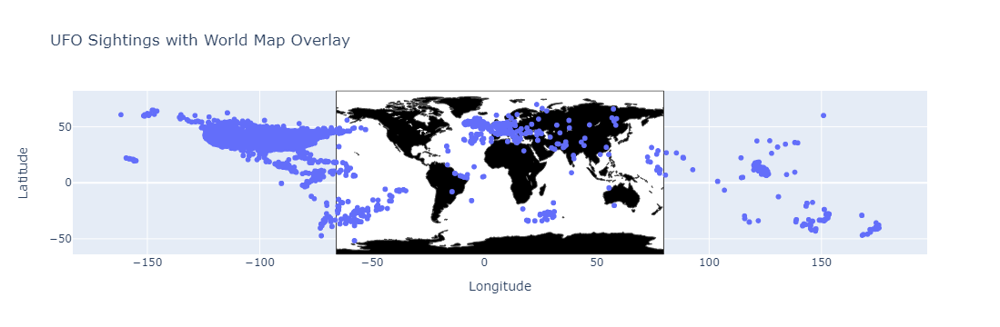

In [895]:
#================ Creating a scatter plot of coordinates with a world-map overlay using Plotly Express:

#====== Plotting the graph:
fig = px.scatter(
    ufo_df,
    x = 'city_longitude',
    y = 'city_latitude' )

#====== Create a map trace with a world map:
# Original source (https://github.com/johan/world.geo.json/blob/master/UNLICENSE)
map_trace = go.Choropleth(
    z = [0],
    showscale = False,
    geojson = 'https://raw.githubusercontent.com/johan/world.geo.json/master/countries.geo.json',
    locations = [],
    hoverinfo = 'location+z',
)

#====== Create a figure with both the scatter plot and the map trace:
fig = go.Figure(data = [fig.data[0], map_trace])

#====== Customize the layout of the combined figure:
fig.update_layout(
    title = 'UFO Sightings with World Map Overlay',
    xaxis_title = 'Longitude',
    yaxis_title = 'Latitude',
    xaxis = dict(showgrid = True),
    yaxis = dict(showgrid = True),
    geo = dict(
        showland = True,
        landcolor = 'black',
    ),
)

#====== Display:
fig.show()


<div class="alert alert-info">
Data Observation:
    
> `By plotting the data points as coordinates, a distinct pattern emerges, revealing the primary locations of UFO sightings around the world. The United States stands out as the top country with the highest number of reported sightings. This observation may suggest either a heightened interest in UFO visitations in the USA or a potential reluctance among individuals to report such incidents compared to the global average.`

> `Additionally, a noteworthy trend is observed between the Northern and Southern Hemispheres, with a higher frequency of UFO encounters reported in the Northern Hemisphere.`

> `Conversely, Africa appears to have fewer reported sightings, indicating a possible lower reporting rate or a lack of significant public attention to UFO phenomena in the region.`
</div>

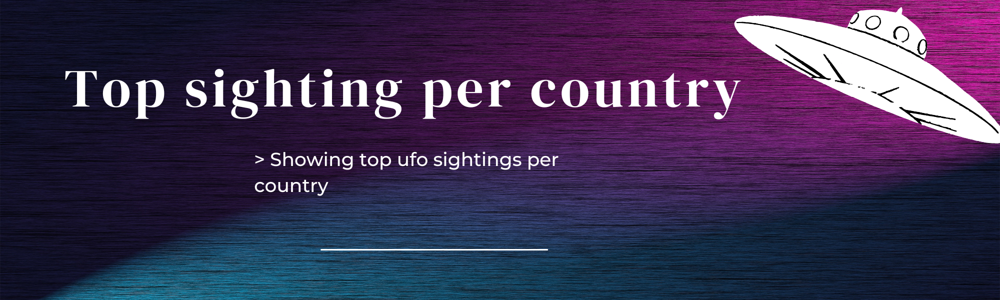

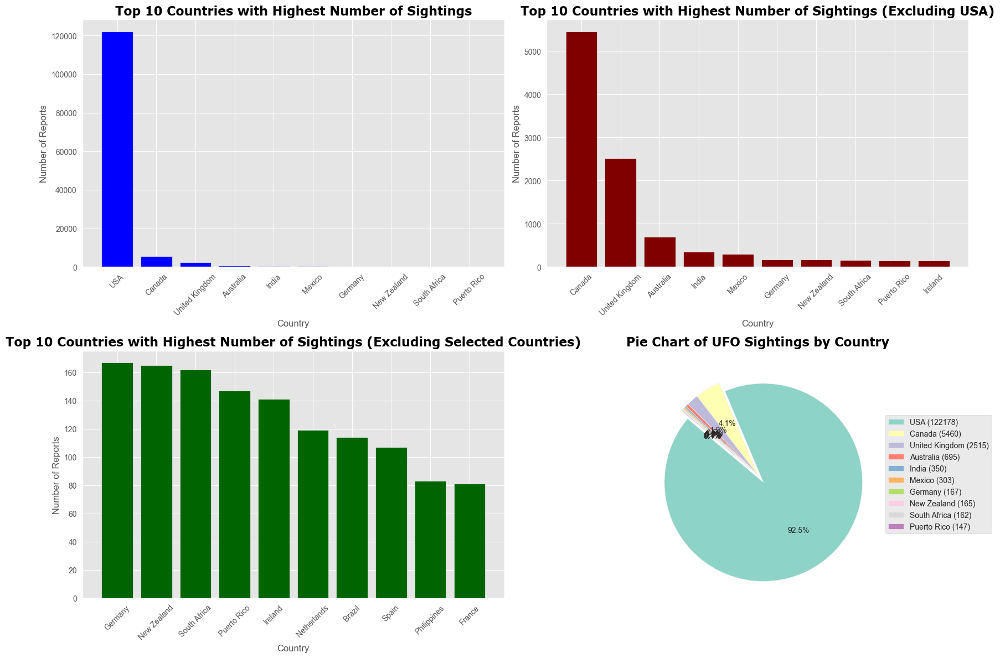

In [896]:
#====== Setting subplots showing total nr Ufo's per country

#====== Set Fig size:
fig, axes = plt.subplots(2, 2, figsize=(18, 12))

#====== Set title font settings
title_font = {
    'fontname': 'Verdana',  
    'color': 'black',    
    'weight': 'bold',       
    'size': 16,             
}

#====== Plot for Top 10 UFO Reports by Country:
country_counts = ufo_df['country'].value_counts()
top_10_countries = country_counts.head(10)

axes[0, 0].bar(top_10_countries.index, top_10_countries.values, color='blue')
axes[0, 0].set_xlabel('Country')
axes[0, 0].set_ylabel('Number of Reports')
axes[0, 0].set_title('Top 10 Countries with Highest Number of Sightings', fontdict=title_font)
axes[0, 0].tick_params(axis='x', rotation=45)

#====== Plot for Top 10 UFO Reports by Country (Excluding USA):
country_counts = ufo_df['country'].value_counts()
country_counts = country_counts.drop('USA', errors='ignore')
top_10_countries = country_counts.head(10)

axes[0, 1].bar(top_10_countries.index, top_10_countries.values, color='maroon')
axes[0, 1].set_xlabel('Country')
axes[0, 1].set_ylabel('Number of Reports')
axes[0, 1].set_title('Top 10 Countries with Highest Number of Sightings (Excluding USA)', fontdict=title_font)
axes[0, 1].tick_params(axis='x', rotation=45)

#====== Plot for Top 10 UFO Reports by Country (Excluding Selected Countries):
country_counts = ufo_df['country'].value_counts()
countries_to_exclude = ['USA', 'Canada', 'United Kingdom', 'Australia', 'India', 'Mexico', 'unknown']
filtered_country_counts = country_counts.drop(countries_to_exclude, errors='ignore')
top_10_countries = filtered_country_counts.head(10)

axes[1, 0].bar(top_10_countries.index, top_10_countries.values, color='darkgreen')
axes[1, 0].set_xlabel('Country')
axes[1, 0].set_ylabel('Number of Reports')
axes[1, 0].set_title('Top 10 Countries with Highest Number of Sightings (Excluding Selected Countries)', fontdict=title_font)
axes[1, 0].tick_params(axis='x', rotation=45)

#====== Plot Pie Chart of UFO Sightings by Country with Exploded Largest Portion:
country_counts = ufo_df['country'].value_counts().reset_index()
country_counts.columns = ['Country', 'Count']

#====== Select the top 10 countries for the pie chart:
top_10_countries = country_counts.head(10)

#====== Create a list to specify explosion for each slice (0 for all slices except the largest one):
explode = [0.1 if country == top_10_countries['Country'].iloc[0] else 0 for country in top_10_countries['Country']]

#====== Create the pie chart with explosion in the lower-right subplot:
ax = axes[1, 1]
wedges, texts, autotexts = ax.pie(top_10_countries['Count'], labels=None, startangle=140, autopct='%1.1f%%', colors=plt.get_cmap('Set3').colors, explode=explode)

#====== Create a legend based on the country names:
legend_labels = [f"{country} ({count})" for country, count in zip(top_10_countries['Country'], top_10_countries['Count'])]
ax.legend(wedges, legend_labels, loc='center left', bbox_to_anchor=(1, 0, 0.5, 1))

#====== Set title:
ax.set_title('Pie Chart of UFO Sightings by Country', fontdict=title_font)

#====== Adjust subplot spacing:
plt.tight_layout()

#====== Show the subplots:
plt.show()


<div class="alert alert-info">
 Data Observation:
    
> `The visualizations unmistakably highlight the USA as the predominant country for UFO sightings, displaying a substantial margin compared to other nations. Canada, neighboring the USA, emerges as the second-highest in reported sightings. Notably, other countries exhibit closer margins among themselves, suggesting a discernible pattern in UFO visitations or encounters. This similarity in sighting numbers across different countries implies a consistent trend or phenomenon in UFO activities worldwide, beyond the significant prevalence observed in the USA.`
    
</div>

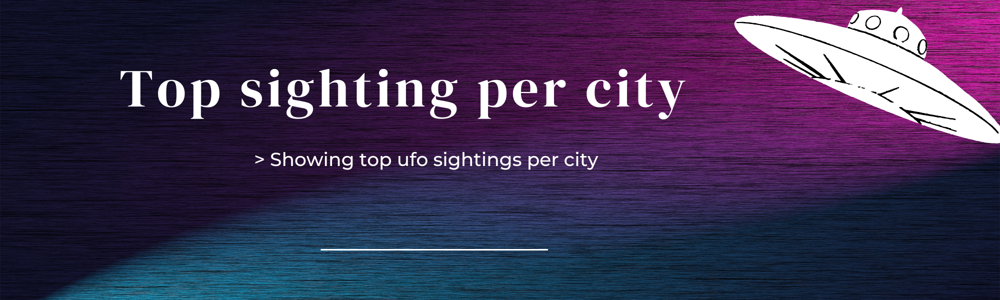

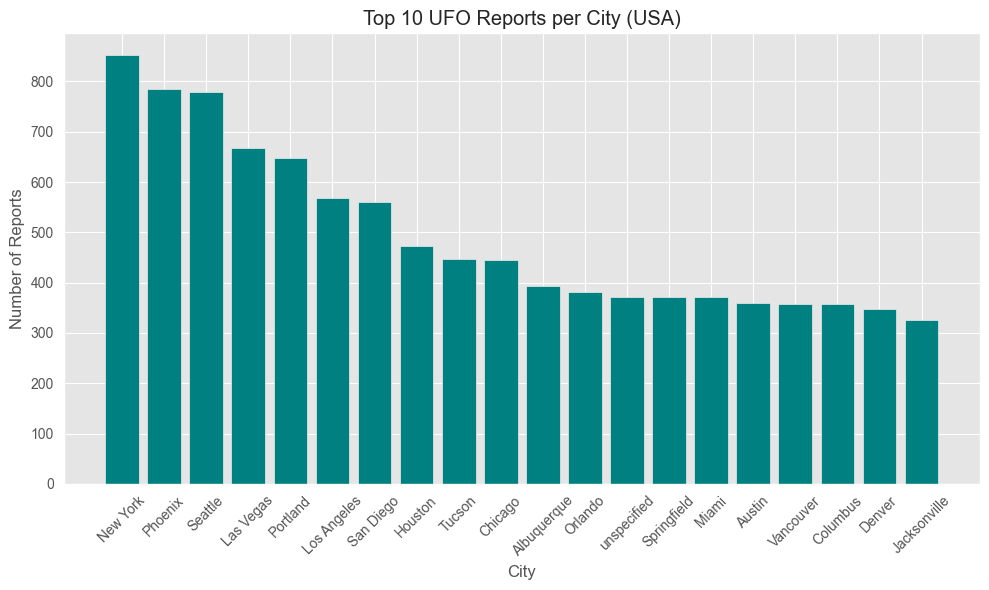

In [897]:
#========== Plotting chart showing top cities with Ufo activity:

#====== Getting city counts:
city_counts = ufo_df['city'].value_counts()

#====== Select the top 10 cities:
top_10_cities = city_counts.head(20)

#====== Setting plot style:
plt.style.use('ggplot')

#====== Plotting bar chart:
plt.figure(figsize = (10, 6))
bars = plt.bar(x=top_10_cities.index, height=top_10_cities.values, color='teal')  # Adjust color as desired

#====== Set titles and labels:
plt.xlabel('City')
plt.ylabel('Number of Reports')
plt.title('Top 10 UFO Reports per City (USA)')

#====== Rotate x-axis labels:
plt.xticks(rotation=45)

#====== Displaying:
plt.tight_layout()
plt.show()


<div class="alert alert-info">
 Data Observation:
    
> `The preeminent cities for UFO sightings are unsurprisingly located in the USA, consistent with the country's overall higher number of UFO reports compared to others. An intriguing observation is that these top cities are predominantly highly populated urban centers. This challenges the skepticism that busy cities might hinder the noticeability of UFO phenomena, as the data suggests otherwise.`

> `Furthermore, the prominence of busy cities, particularly during the night, raises questions about the connection between UFO sightings and nightlife. The prevalence of sightings in cities with active nighttime activities indicates that UFOs, often described as lights, are more conspicuous during nocturnal hours. This prompts speculation about the potential existence of UFOs that go unnoticed during daylight due to sunlight.`

> `Additionally, the mention of Phoenix brings to mind the widely reported Phoenix Lights incident on March 13, 1997. The collective sighting of unidentified flying objects in the skies over Arizona and Nevada could contribute to heightened awareness and more UFO reports in the area. The geographical characteristics of Phoenix, situated amidst open spaces and desert terrain with minimal light pollution, might also play a role in enhancing visibility and facilitating UFO sightings`
</div>

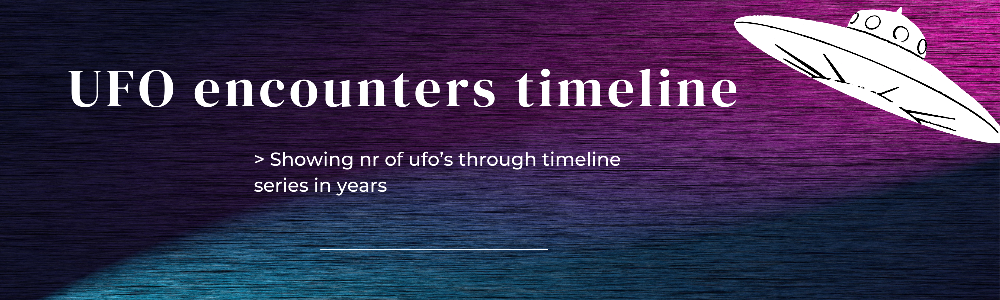

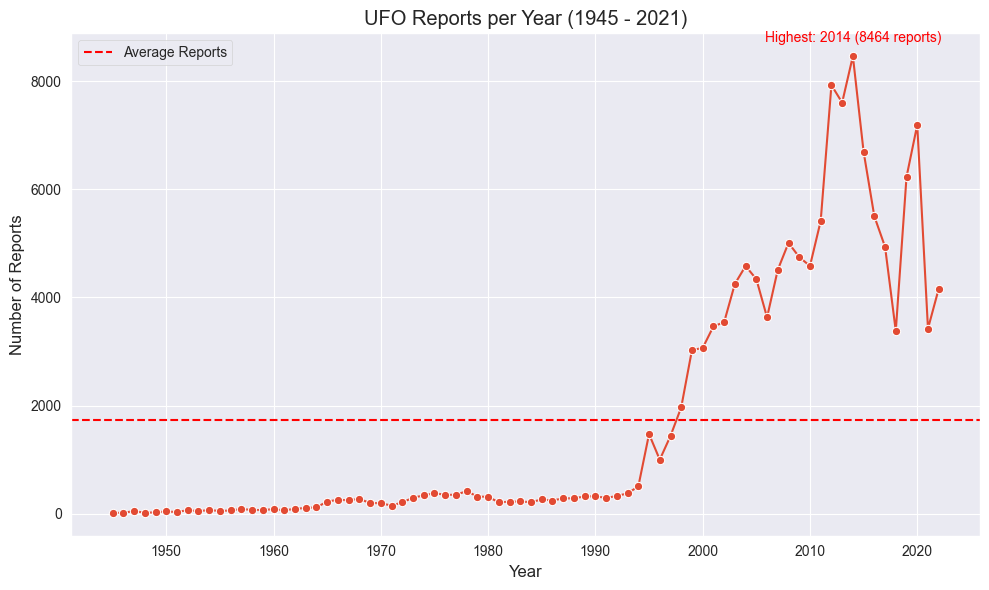

In [898]:
#========== Setting line chart to show UFO encounters timeline:

#====== Convert 'date_only' column to datetime format:
ufo_df['date_only'] = pd.to_datetime(ufo_df['date_only'])

#====== Extract the year from the 'date_only' column:
ufo_df['year'] = ufo_df['date_only'].dt.year

#====== Filter data to include years from 1945 and onwards:
ufo_df = ufo_df[ufo_df['year'] >= 1945]

#====== Count the number of reports per year:
reports_per_year = ufo_df['year'].value_counts().sort_index()

#====== Calculate the average number of reports per year:
average_reports = reports_per_year.mean()

#====== Setting the chart style:
sns.set_style("darkgrid")

#====== Plotting line chart:
plt.figure(figsize = (10, 6))
lineplot = sns.lineplot(x = reports_per_year.index, y = reports_per_year.values, marker = 'o')

#====== Add a horizontal line for the average number of reports:
plt.axhline(average_reports, color = 'red', linestyle = '--', label = 'Average Reports')

#====== Set title and labels:
plt.xlabel('Year')
plt.ylabel('Number of Reports')
plt.title('UFO Reports per Year (1945 - 2021)')

#====== Find the year with the highest number of reports:
highest_year = reports_per_year.idxmax()
highest_count = reports_per_year.max()

#====== Annotate the highest point with the year and count:
plt.annotate(f'Highest: {highest_year} ({highest_count} reports)', (highest_year, highest_count),
             textcoords="offset points", xytext = (0, 10), ha = 'center',color = 'red')

#====== Display the chart:
plt.legend()  # Add a legend
plt.tight_layout()
plt.show()


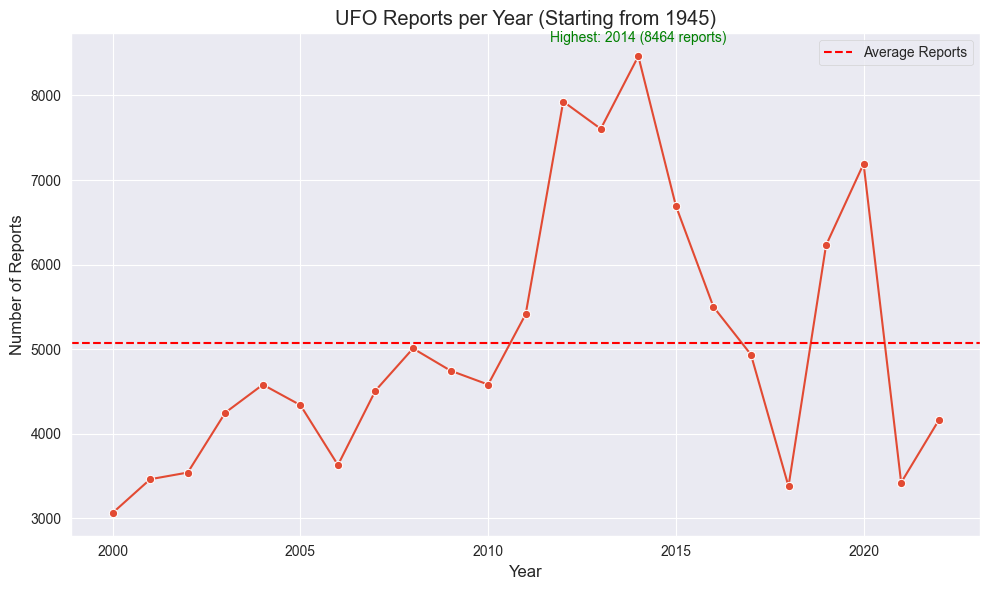

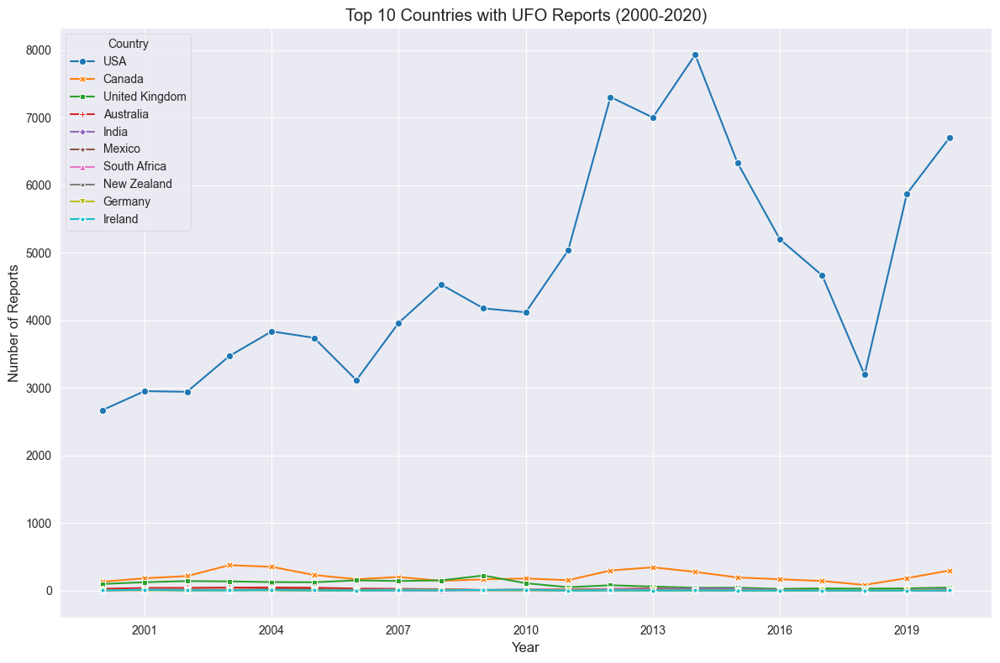

In [899]:
#========== Plotting first chart showing UFO encounters per year (2020 upwwards):

#====== Convert 'date_only' column to datetime format:
ufo_df['date_only'] = pd.to_datetime(ufo_df['date_only'])

#====== Extract the year from the 'date_only' column:
ufo_df['year'] = ufo_df['date_only'].dt.year

#====== Filter data to include years from 2000 and onwards:
ufo_df = ufo_df[ufo_df['year'] >= 2000]

#====== Count the number of reports per year:
reports_per_year = ufo_df['year'].value_counts().sort_index()

#====== Calculate the average number of reports per year:
average_reports = reports_per_year.mean()

#====== set the chart style:
sns.set_style("darkgrid")

#====== Plotting line chart:
plt.figure(figsize = (10, 6))
lineplot = sns.lineplot(x = reports_per_year.index, y = reports_per_year.values, marker = 'o')

#====== Add a horizontal line for the average number of reports:
plt.axhline(average_reports, color='red', linestyle='--', label = 'Average Reports')

#====== Setting plot titae and labels:
plt.xlabel('Year')
plt.ylabel('Number of Reports')
plt.title('UFO Reports per Year (Starting from 1945)')

#====== Find the year with the highest number of reports:
highest_year = reports_per_year.idxmax()
highest_count = reports_per_year.max()

#====== Annotate the highest point with the year and count:
plt.annotate(f'Highest: {highest_year} ({highest_count} reports)', (highest_year, highest_count),
             textcoords="offset points", xytext = (0, 10), ha = 'center',color = 'green')

#====== Display the plot:
plt.legend()  # Add a legend
plt.tight_layout()
plt.show()

#========== Plotting 2nd chart showing UFO encounters per year (between 2000 - 2020) and showing country as well:
#====== Convert the 'date_only' column to a datetime type:
ufo_df['date_only'] = pd.to_datetime(ufo_df['date_only'])

#====== Extract the year from the 'date_only' column:
ufo_df['year'] = ufo_df['date_only'].dt.year

#====== Filter data to include years from 2000 to 2020:
ufo_df_filtered = ufo_df[(ufo_df['year'] >= 2000) & (ufo_df['year'] <= 2020)]

#====== Count the number of reports per year and per country:
reports_per_year_and_country = ufo_df_filtered.groupby(['year', 'country']).size().unstack(fill_value = 0)

#====== Get the top 10 countries with the most reports over the years 2000-2020:
top_10_countries = reports_per_year_and_country.sum().nlargest(10).index

#====== Filter the data to include only the top 10 countries:
reports_per_year_and_country = reports_per_year_and_country[top_10_countries]

#====== Plotting line chart:
plt.figure(figsize = (12, 8))
sns.set_style("darkgrid")

#====== Use palette to control line colors:
palette = sns.color_palette("tab10", len(top_10_countries))
sns.lineplot(data = reports_per_year_and_country, dashes = False, markers = True, palette = palette)

#====== Set title and label:
plt.xlabel('Year')
plt.ylabel('Number of Reports')
plt.title('Top 10 Countries with UFO Reports (2000-2020)')

#====== Set the x-axis tick locator to integers
plt.gca().xaxis.set_major_locator(plt.MaxNLocator(integer = True))

#====== Display the plot:
plt.legend(title = 'Country')
plt.tight_layout()
plt.show()


<div class="alert alert-info">
 Data Observation:
    
> `The surge in UFO sightings in the 21st century, especially leading into the 2000s, can be attributed to several factors, reflecting changes in technology, societal awareness, and global events. The sudden advancement of technology, including faster internet speeds and the ability to report sightings digitally, likely played a role. Additionally, the influence of popular culture, with movies like "Independence Day" (1996) portraying UFOs and aliens, may have sparked increased interest and awareness in the public.`

> `The notable spike in sightings in 2014 could be linked to a combination of factors. The increasing prevalence of advanced video cameras and smartphones during that time may have contributed to more individuals capturing and reporting sightings. Moreover, the peak aligns with a period of heightened global events, such as increased military activity and geopolitical tensions.`

> `The period from 2010 to 2015 saw a substantial increase in sightings, prompting speculation about potential influencing factors. The aftermath of 9/11 is mentioned as a potential trigger, with people being more vigilant and alert to objects in the sky due to fear of potential terrorist attacks. Another theory suggests that the global military pressure, especially in the USA with troops deployed to the Middle East, might have attracted attention from unidentified beings or led to misinterpretations of military activities as UFO sightings.`

> `It's interesting to note that this spike in sightings is more pronounced in the USA, indicating a unique pattern compared to other countries. The absence of a similar anomaly in other nations suggests that the influencing factors might be specific to the USA, potentially related to its geopolitical situation and global military involvement.`

> `The mention of President Barack Obama's order in June 2014, responding to the Northern Iraq offensive, adds another layer of complexity. While it might be challenging to establish a direct correlation, geopolitical events and military activities could contribute to heightened awareness and observation of the skies, impacting the number of reported UFO sightings.`
</div>

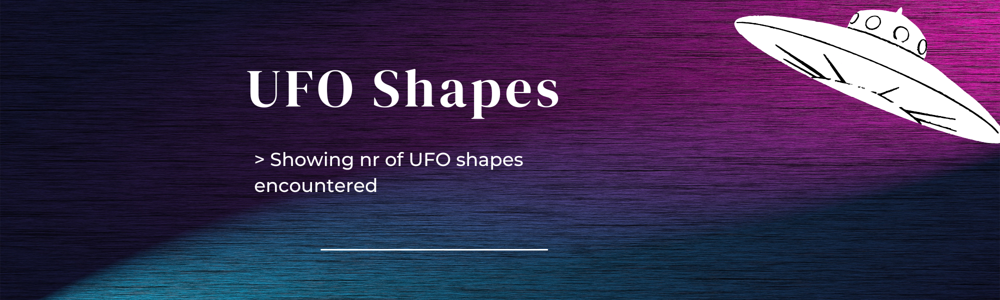

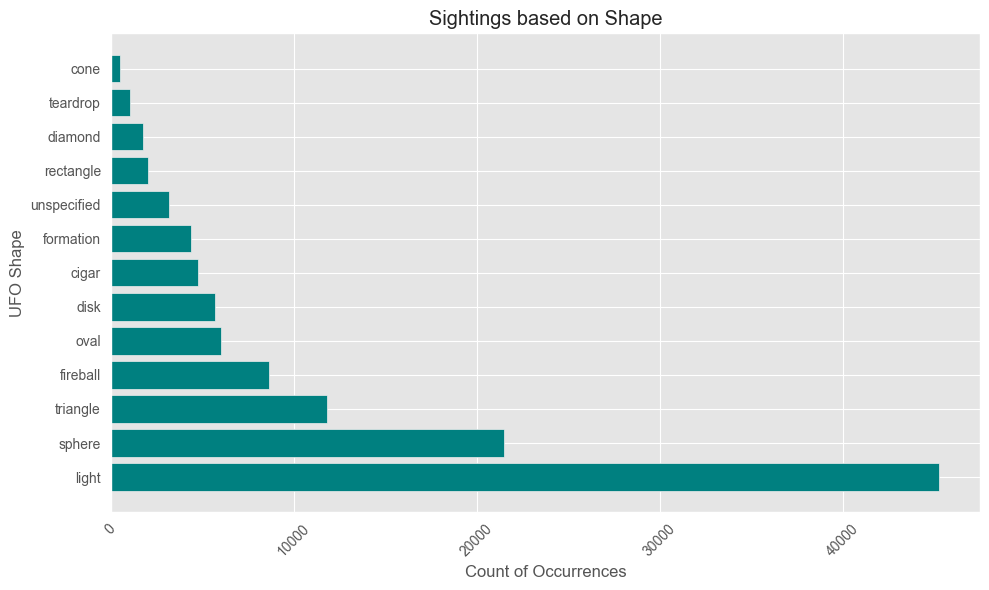

In [900]:
#========== Plotting chart showing Ufo shape counts:

#====== Getting shapes count:
shape_counts = ufo_df['shape'].value_counts()

plt.style.use('ggplot')  # Setting plot style

#====== Plotting a horizontal bar chart:
plt.figure(figsize = (10, 6))
bars = plt.barh(y = shape_counts.index, width=shape_counts.values, color='teal')  # Adjust color as desired

#====== Setting titles and labels:
plt.xlabel('Count of Occurrences')
plt.ylabel('UFO Shape')
plt.title('Sightings based on Shape')

#====== Rotate x-axis labels:
plt.xticks(rotation=45)

# ====== Display:
plt.tight_layout()
plt.show()


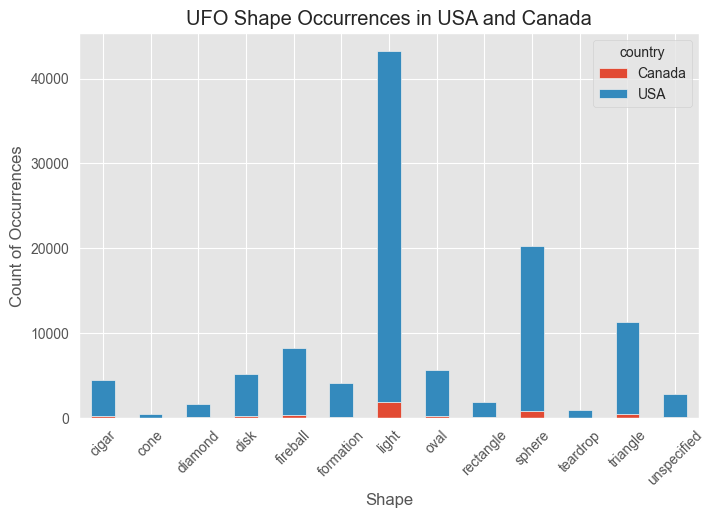

In [901]:
#========== Setting chart displaying nr of UFO sightings per country:

#====== Extract top cities counts:
top_10_countries = ufo_df['country'].value_counts().head(10).index

#====== Filter the DataFrame for 'USA' and 'Canada':
filtered_df = ufo_df[ufo_df['country'].isin(['USA', 'Canada'])]

#====== Pivot the data to count UFO shape occurrences by country and transpose:
pivot_df = filtered_df.pivot_table(index='country', columns = 'shape', aggfunc = 'size', fill_value = 0).T

#====== Plotting bar chart:
ax = pivot_df.plot(kind = 'bar', stacked = True, figsize = (8, 5))
plt.title('UFO Shape Occurrences in USA and Canada')
plt.xlabel('Shape')
plt.ylabel('Count of Occurrences')
plt.xticks(rotation = 45)

#====== Display plot:
plt.show()



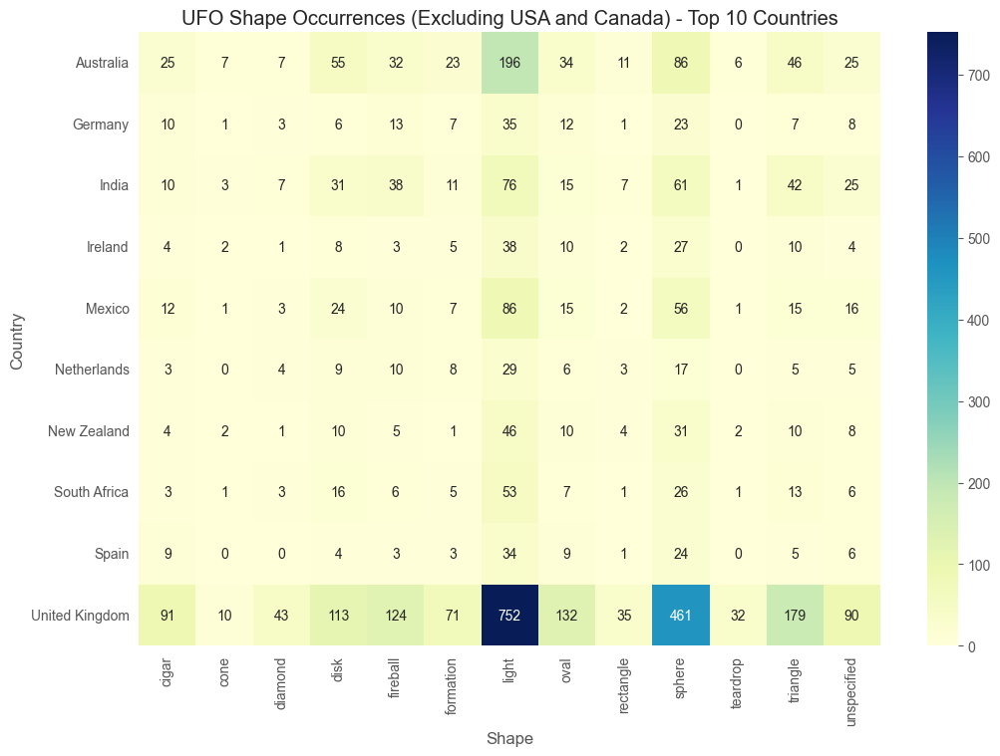

In [902]:
import seaborn as sns

#========== Setting chart displaying nr of UFO sightings per country:
#====== Extract top cities counts:
top_10_countries = ufo_df['country'].value_counts().head(12).index  # Include the top 12 countries

#====== Filter the DataFrame for all countries except 'USA' and 'Canada':
filtered_df = ufo_df[~ufo_df['country'].isin(['USA', 'Canada'])]

#====== Extract top 10 countries after excluding 'USA' and 'Canada':
remaining_top_10_countries = filtered_df['country'].value_counts().head(10).index

#====== Filter the DataFrame for the top 10 countries after exclusion:
final_filtered_df = filtered_df[filtered_df['country'].isin(remaining_top_10_countries)]

#====== Pivot the data to count UFO shape occurrences by country:
pivot_df = final_filtered_df.pivot_table(index='country', columns='shape', aggfunc='size', fill_value=0)

#====== Plotting heatmap:
plt.figure(figsize=(12, 8))
sns.heatmap(pivot_df, cmap="YlGnBu", annot=True, fmt="d", cbar=True)
plt.title('UFO Shape Occurrences (Excluding USA and Canada) - Top 10 Countries')
plt.xlabel('Shape')
plt.ylabel('Country')

#====== Display plot:
plt.show()


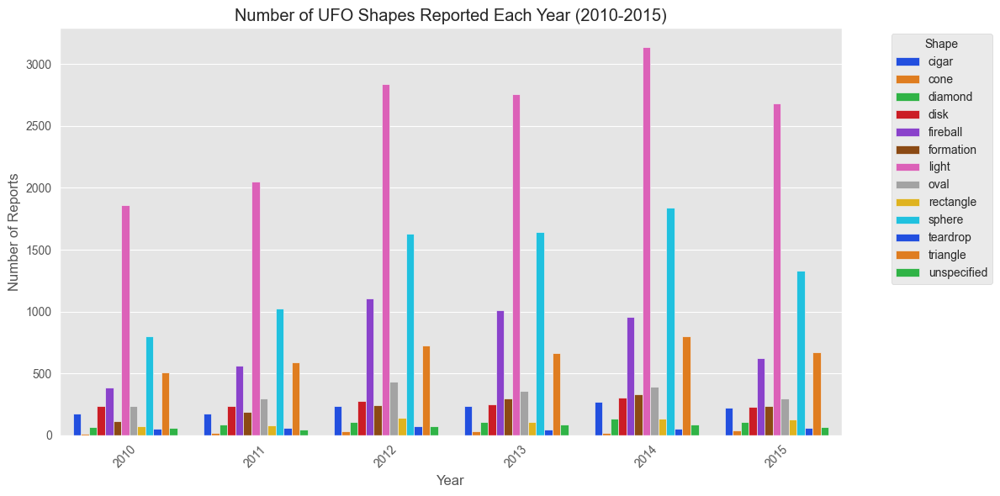

In [903]:
#========= Plotting another plot showing UFO shapes per year:

#====== Convert the 'date_only' column to a datetime type:
ufo_df['date_only'] = pd.to_datetime(ufo_df['date_only'])

#====== Filtering records(year range 2010-2015):
filtered_df = ufo_df[(ufo_df['date_only'].dt.year >= 2010) & (ufo_df['date_only'].dt.year <= 2015)]

#====== Group by 'year' and 'shape' and calculate counts:
year_shape_counts = filtered_df.groupby([filtered_df['date_only'].dt.year, 'shape']).size().reset_index(name = 'count')

#====== Setting barplot:
plt.figure(figsize = (12, 6))
sns.barplot(x = 'date_only', y='count', hue='shape', data = year_shape_counts, palette='bright')
plt.xlabel('Year')
plt.ylabel('Number of Reports')
plt.title('Number of UFO Shapes Reported Each Year (2010-2015)')

#====== Legend re-adjust position:
plt.legend(title='Shape', loc='upper right', bbox_to_anchor = (1.2, 1.0))

plt.xticks(rotation = 45)

#====== Display:
plt.tight_layout()
plt.show()


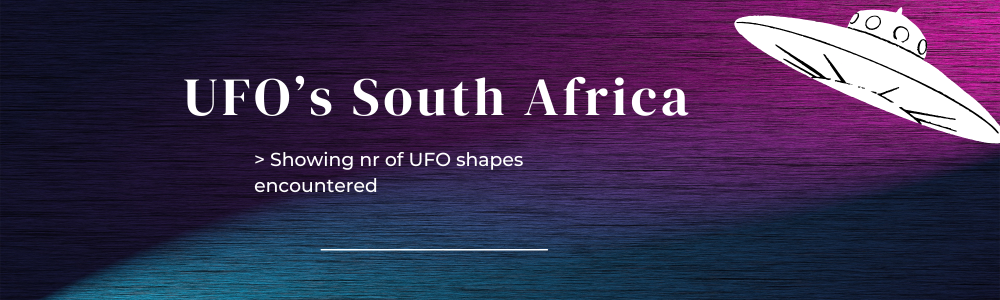

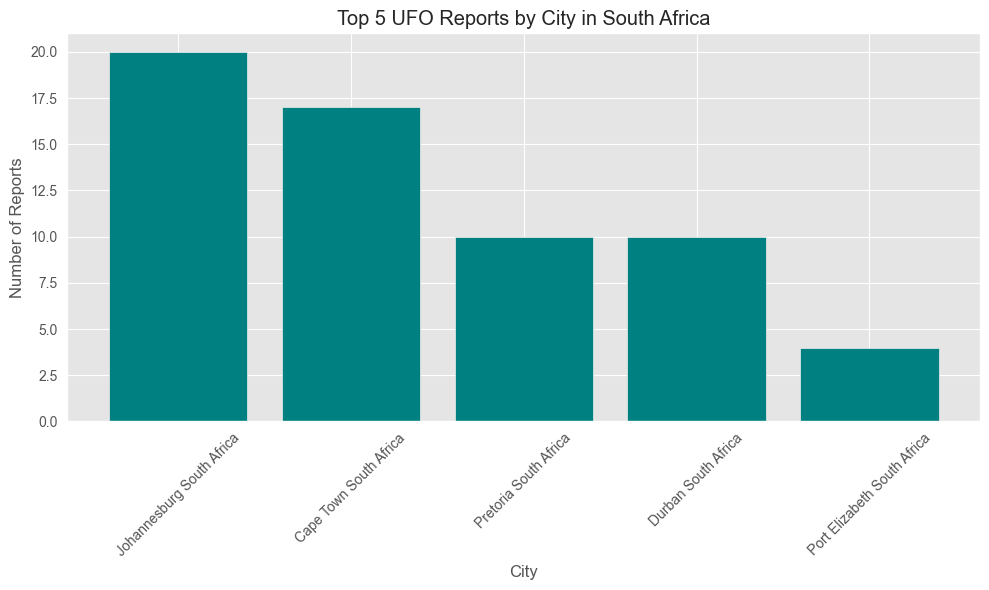

In [904]:
#========= Plotting chart showing Ufo sightings per city in South Africa:

#====== Filtering to extract values from country South Africa only:
south_africa_df = ufo_df[ufo_df['country'] == 'South Africa']

#====== Count nr of reports per city:
city_counts = south_africa_df['city'].value_counts()

#====== Select the top 5 cities in South Africa:
top_5_cities = city_counts.head(5)

#====== Setting style for chart:
plt.style.use('ggplot') 

#===== Plotting barplot:
plt.figure(figsize = (10, 6))
bars = plt.bar(x = top_5_cities.index, height = top_5_cities.values, color = 'teal')  # Adjust color as desired

#===== Add labels and title
plt.xlabel('City')
plt.ylabel('Number of Reports')
plt.title('Top 5 UFO Reports by City in South Africa')

#====== Rotate x-axis labels:
plt.xticks(rotation = 45)

#====== Display the plot:
plt.tight_layout()
plt.show()

In [905]:
#====== Defining function that returns most common Ufo shape:
def find_most_common_shape(df, target_country):
    # Filter the DataFrame to include only the target country
    country_data = df[df['country'] == target_country]

    if country_data.empty:
        return None, 0  # Return None if no data for the country

    # Find the mode of the 'shape' column (most common shape)
    most_common_shape = country_data['shape'].mode().values[0]

    # Count the occurrences of the most common shape
    occurrences = country_data[country_data['shape'] == most_common_shape]['shape'].count()

    return most_common_shape, occurrences


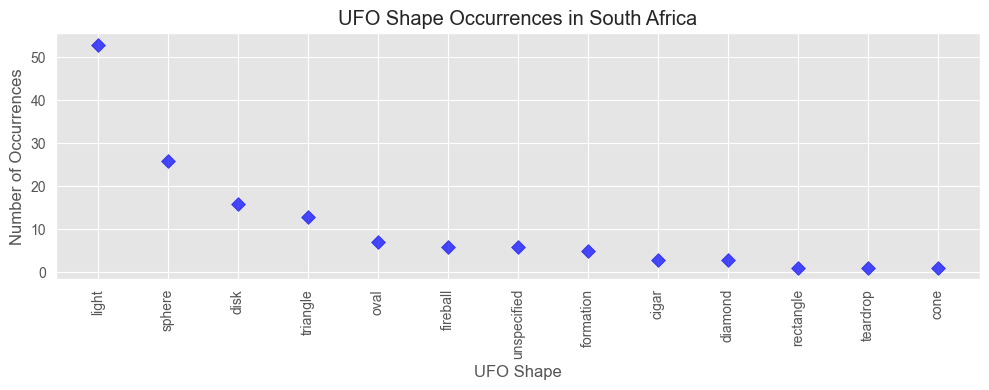

In [906]:
#======== Initiatilising function above:

#====== Filter the DataFrame to include only 'South Africa'
sa_data = ufo_df[ufo_df['country'] == 'South Africa']

#====== Count the occurrences of each unique shape in South Africa
shape_counts = sa_data['shape'].value_counts()

#====== Plotting scatterplot:
plt.figure(figsize = (10, 4))
plt.scatter(shape_counts.index, shape_counts.values, s=50, c='blue', alpha=0.7, marker = "D")
plt.xlabel('UFO Shape')
plt.ylabel('Number of Occurrences')
plt.title('UFO Shape Occurrences in South Africa')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.grid(True)

#====== Display:
plt.tight_layout()
plt.show()


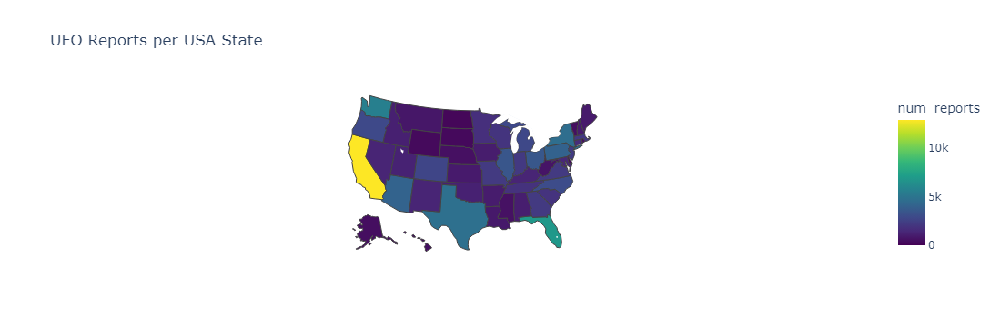

In [907]:
#========== Plotting heat map/area chart for USA States and nr of ufo encounters:

#====== Filtering data for USA only:
usa_ufo_df = ufo_df[ufo_df['country'] == 'USA']

#====== Calculate the number of UFO reports per state
state_counts = usa_ufo_df['state'].value_counts().reset_index()
state_counts.columns = ['state', 'num_reports']

#====== Create the choropleth map
fig = px.choropleth(
    state_counts,
    locations='state',  # Column containing state codes or names
    locationmode='USA-states',  # Use USA state abbreviations as location mode
    color='num_reports',  # Column containing the values to be plotted
    scope='usa',  # Map scope (USA)
    hover_name='state',  # Column for hover text (state names)
    title='UFO Reports per USA State',  # Title of the map
    color_continuous_scale='Viridis'
)

#====== Display the map:
fig.show()

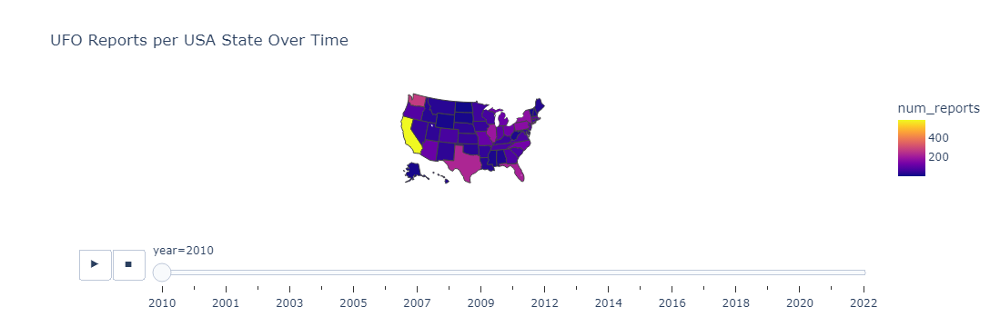

In [908]:
#========== Plotting heat map/area chart for USA States and nr of ufo encounters per timeline:

#====== Extract the year from the 'date_time' column:
usa_ufo_df['year'] = pd.to_datetime(usa_ufo_df['date_only']).dt.year

#====== Calculate the number of UFO reports per state and year
state_year_counts = usa_ufo_df.groupby(['state', 'year']).size().reset_index(name='num_reports')

#====== Create the choropleth map
fig = px.choropleth(
    state_year_counts,
    locations='state',  # Column containing state codes or names
    locationmode='USA-states',  # Use USA state abbreviations as location mode
    color='num_reports',  # Column containing the values to be plotted
    scope='usa',  # Map scope (USA)
    hover_name='state',  # Column for hover text (state names)
    animation_frame='year',  # Column for animation (year)
    title='UFO Reports per USA State Over Time'  # Title of the map
)

#====== Display map:
fig.show()


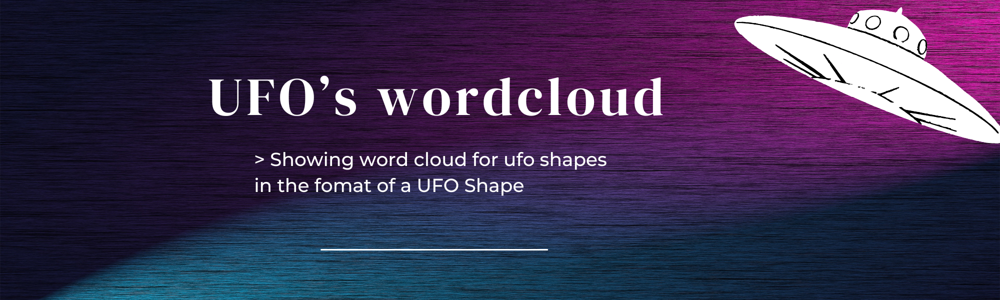

In [909]:
#====== Using NL Toolkit to display frequency of ufo shape texts

#====== Download stopwords library:
nltk.download('stopwords')

#====== Tokenizing the 'summary' text:
ufo_df['summary'] = ufo_df['summary'].str.lower().str.split() # Convert to lowercase

#====== Removing stopwords:
stop_words = set(stopwords.words('english'))
ufo_df['summary'] = ufo_df['summary'].apply(lambda tokens: [word for word in tokens if word not in stop_words])

#====== Setting counter to count word frequecies:
word_counts = Counter()

for summary_tokens in ufo_df['summary']:
    word_counts.update(summary_tokens) # Apply tokens

#====== Finding the most common words: 
most_common_words = word_counts.most_common(30)  # Setting to 20 most common

#====== Display the most common words and their frequencies
print("Top 50 most common words:\n")

for word, count in most_common_words:
    print(f"\n{word}: {count}")


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\warri\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Top 50 most common words:


lights: 25226

light: 24958

bright: 20041

sky: 19449

object: 18275

moving: 14079

orange: 12538

white: 12494

red: 11641

saw: 9769

seen: 7886

flying: 7757

shaped: 7576

like: 7437

sky.: 6473

craft: 6356

two: 6204

objects: 5832

ufo: 5828

large: 5642

3: 5596

one: 5356

note:: 5290

pd: 5223

nuforc: 5203

across: 5198

green: 5184

2: 5077

hovering: 4998

night: 4929


# <font color='red'><center>_____ _________________ _____________________________</center></font>



# <font color= ##033295  ><span style='font-family:Bell MT'>Final closing:</span></font>

<div class="alert alert-success" markdown="1">
<font size="3"><center></font>
* The following outlines the final summary of findings:

</div>

#### UFO Reports

&#x2071; In conclusion, this analysis of UFO reports from the National UFO Research Center highlights compelling insights gained through rigorous data cleaning and analytics. Visualizations reveal distinct patterns, with the USA prominently leading in sightings, possibly reflecting heightened reporting or genuine interest. Contrary to expectations, urban areas, particularly at night, exhibit significant UFO activity, challenging assumptions about visibility amidst city lights. Events like the Phoenix Lights and societal factors such as technological advancements contribute to spikes in reports, notably in the early 2000s and around 2014, especially within the USA. These findings underscore the complex interplay of socio-cultural influences and technological developments on global UFO sightings


# <font color='red'><center>_____ _________________ _____________________________</center></font>